In [221]:
import numpy as np
import trimesh
import networkx as nx
import scipy
import matplotlib.pyplot as plt
import robust_laplacian
from mesh_dataset_utils import *

In [222]:
mesh1 = trimesh.load('/Users/kevin/textureProject/GINR-texture/meshes/Spikeyball1.stl')
mesh1.show()

In [223]:
dataset, smooth = build_offset_dataset(mesh1, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth.show()

In [224]:
blankdataset = build_blank_dataset(smooth, "spikeboi1")

In [225]:
import os
import torch
from MLP import MLP

In [226]:
traindatax = torch.Tensor(dataset["fourier"]).float()
traindatay = torch.Tensor(dataset["target"]).float()

In [227]:
model = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [228]:
trainingDataset = torch.utils.data.TensorDataset(traindatax, traindatay)

In [229]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [230]:
all_predictions = []
all_batches = []

In [231]:
for i in range(10):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions.append(a.detach().numpy())
                
            all_batches.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0005474
0.99175423
0.99153256
0.98941034
0.97357273
0.97045225
0.955637
0.9489786
0.9615933
0.9376027
0.9284296
0.9225508
0.9191149
0.9008913
0.9107432
0.90872073
0.9041906
0.909181
0.8580815
0.83247817
0.8858707
0.8032256
0.86651903
0.76001483
0.8413895
0.8477108
0.7837627
0.8229889
0.7810708
0.76622605
0.78349626
0.77587557
0.71418947
0.7357873
0.7446556
0.7539054
0.7228471
0.7156987
0.6976788
0.69154924
0.6908837
0.69654566
0.66595316
0.6934746
0.6987496
0.6335103
0.6204337
0.6647358
0.69573045
0.71217906
0.67342097
0.6832482
0.65007114
0.6638524
0.6410632
0.61010367
0.6436039
0.54596156
0.51192755
0.5777536
0.5859318
0.6124932
0.6059116
0.55968726
0.56492597
0.521375
0.592033
0.5625499
0.56060773
0.5268151
0.577283
0.50932926
0.5204936
0.5128473
0.48999768
0.47347975
0.5160888
0.47398567
0.5096979
0.47564545
0.51435053
0.46770826
0.4550346
0.50405335
0.4258514
0.46214315
0.43995997
0.441118
0.43733492
0.45047617
0.46396428
0.37771305
0.43730307
0.37782878
0.39894405
0.40113908
0.

42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

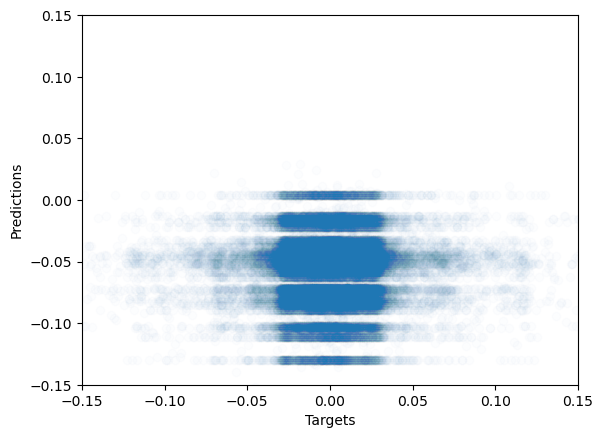

In [232]:
all_batches_fix = []
for i in all_batches:
    for j in i:
        all_batches_fix.append(j)

all_targets_x = [yuh[0] for yuh in all_batches_fix]
#print(all_batches)
print(len(all_targets_x))
all_predictions_x = [yuh[0] for yuh in all_predictions]
print(np.array(all_predictions).shape)
print(len(all_predictions_x))
plt.scatter(all_targets_x, all_predictions_x, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

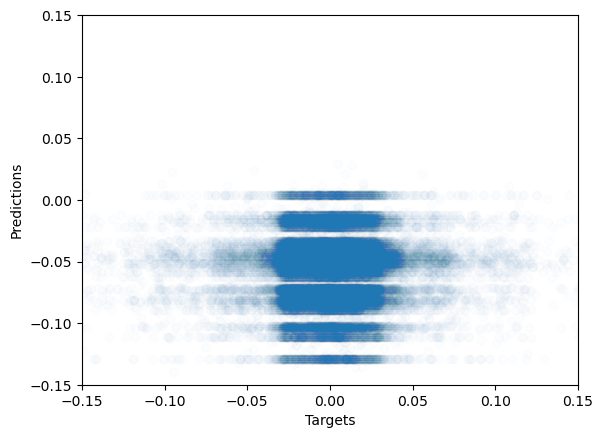

In [233]:
all_targets_y = [yuh[1] for yuh in all_batches_fix]
print(len(all_targets_y))
all_predictions_y = [yuh[1] for yuh in all_predictions]
print(len(all_predictions_y))
plt.scatter(all_targets_y, all_predictions_y, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

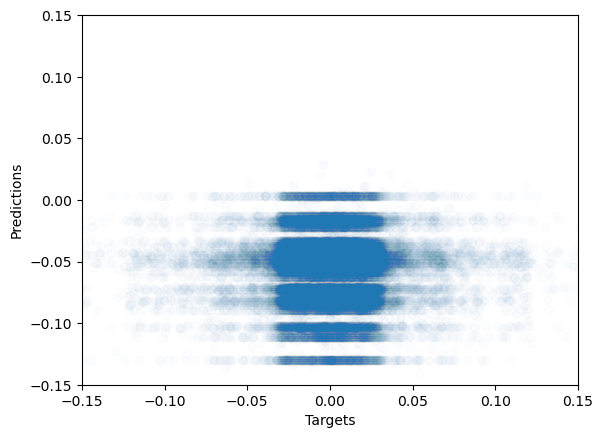

In [234]:
all_targets_z = [yuh[2] for yuh in all_batches_fix]
print(len(all_targets_z))
all_predictions_z = [yuh[2] for yuh in all_predictions]
print(len(all_predictions_z))
plt.scatter(all_targets_z, all_predictions_z, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [292]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load("/Users/kevin/textureProject/GINR-texture/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[-0.0717, -0.0715, -0.0714],
        [-0.0172, -0.0171, -0.0166],
        [-0.0262, -0.0265, -0.0263],
        [-0.0226, -0.0225, -0.0224],
        [-0.0394, -0.0392, -0.0394],
        [-0.0448, -0.0446, -0.0448],
        [-0.0170, -0.0168, -0.0172],
        [-0.0637, -0.0638, -0.0636],
        [-0.0656, -0.0664, -0.0658],
        [-0.0631, -0.0635, -0.0630],
        [-0.0607, -0.0610, -0.0606],
        [-0.0193, -0.0193, -0.0191],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
        [-0.0484, -0.0482, -0.0483],
 

In [293]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

In [237]:
model2 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [238]:
trainingLoad = torch.utils.data.DataLoader(trainingDataset, batch_size = 1000, shuffle = True)

lossfunc = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), .0001)

In [239]:
all_predictions2 = []
all_batches2 = []

In [240]:
for i in range(10):
    for batch in trainingLoad:
        
        optimizer.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions2.append(a.detach().numpy())
                
            all_batches2.append(Ybatch.detach().numpy())
        
        error = lossfunc(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer.step()

1.0007311
1.001959
0.99962604
1.0023626
0.9995242
0.9973208
1.0013436
1.0006707
1.0024273
1.002219
0.99923015
1.0008892
1.001068
1.0012075
1.0014497
0.99955744
1.0006508
1.0004903
1.0009936
1.0013517
1.0017791
1.0021905
1.0008336
1.0010039
0.99855965
1.0000681
0.99958414
1.001306
1.0019379
0.9997158
1.0004592
1.0000926
0.99996394
0.9996523
1.0012673
0.998802
0.99996465
0.9986778
1.0008072
1.0013902
0.9997053
1.0006899
1.000573
0.9989904
1.0015292
0.99889225
1.003744
1.0011595
1.0012354
1.0019323
1.0008072
0.99912906
1.0009817
1.003136
0.99939126
1.0007689
1.0012304
1.0012939
1.0010242
0.9999501
1.0003858
0.99982
0.9985107
1.0017363
1.0007466
0.99902314
1.0014604
1.0013527
1.000343
1.0008037
1.00105
1.0005469
1.0004874
0.9999639
1.0005773
0.99794
1.0018681
1.000201
1.0014511
1.0015392
1.0020524
0.99915594
0.99955475
0.9995836
1.0005796
0.9975162
1.0016935
1.0015827
0.99975026
1.0004256
1.0001894
0.99968743
1.0017791
1.0000277
0.99984497
0.9996386
1.0019102
0.9994096
1.0018371
1.0006722


42787
(42787, 3)
42787


Text(0, 0.5, 'Predictions')

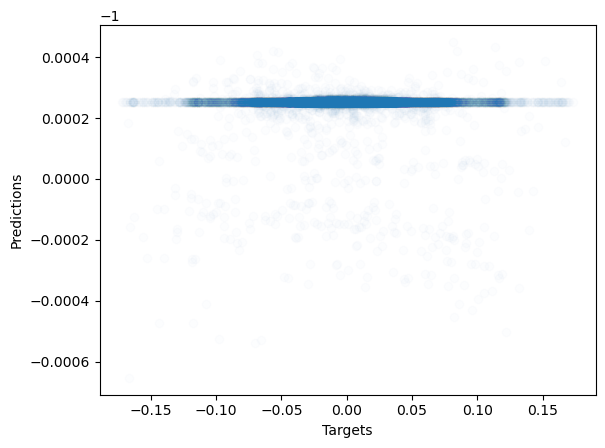

In [241]:
all_batches_fix2 = []
for i in all_batches2:
    for j in i:
        all_batches_fix2.append(j)

all_targets_x2 = [yuh[0] for yuh in all_batches_fix2]
#print(all_batches)
print(len(all_targets_x2))
all_predictions_x2 = [yuh[0] for yuh in all_predictions2]
print(np.array(all_predictions2).shape)
print(len(all_predictions_x2))
plt.scatter(all_targets_x2, all_predictions_x2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

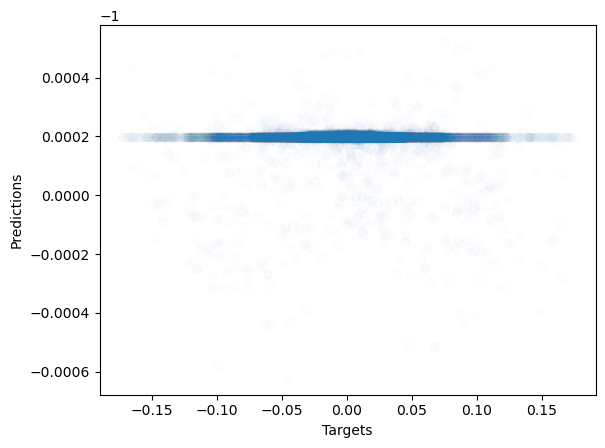

In [242]:
all_targets_y2 = [yuh[1] for yuh in all_batches_fix2]
print(len(all_targets_y2))
all_predictions_y2 = [yuh[1] for yuh in all_predictions2]
print(len(all_predictions_y2))
plt.scatter(all_targets_y2, all_predictions_y2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

42787
42787


Text(0, 0.5, 'Predictions')

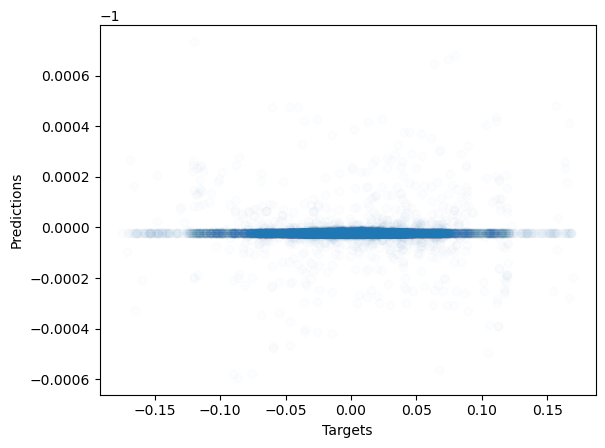

In [243]:
all_targets_z2 = [yuh[2] for yuh in all_batches_fix2]
print(len(all_targets_z2))
all_predictions_z2 = [yuh[2] for yuh in all_predictions2]
print(len(all_predictions_z2))
plt.scatter(all_targets_z2, all_predictions_z2, alpha = 0.01)
#plt.xlim(-.15, .15)
#plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [244]:
ball = get_sphere(3)
blankdataset = build_blank_dataset(ball, "softboi1")

testDataset = np.load("/Users/kevin/textureProject/GINR-texture/softboi1/npz_files/softboi1.npz")
xtestDataset = testDataset["fourier"]

predicts = model2(torch.Tensor(xtestDataset).float())
predicts[:50]

tensor([[-0.9997, -1.0000, -1.0001],
        [-1.0000, -0.9999, -1.0000],
        [-1.0000, -1.0002, -0.9999],
        [-1.0001, -1.0002, -1.0004],
        [-0.9995, -1.0000, -0.9999],
        [-1.0002, -1.0001, -0.9998],
        [-1.0002, -0.9997, -0.9996],
        [-1.0000, -0.9999, -0.9997],
        [-1.0005, -0.9996, -1.0003],
        [-1.0001, -0.9996, -1.0003],
        [-0.9994, -1.0000, -0.9999],
        [-1.0001, -0.9999, -0.9998],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
        [-0.9997, -0.9998, -1.0000],
 

In [245]:
yuh = generate_pred_mesh(predicts.detach().numpy(), ball)
yuh.show()

In [255]:
mesh2 = trimesh.load('/Users/kevin/textureProject/GINR-texture/meshes/Spikeyball2.stl')
mesh2.show()

In [256]:
dataset2, smooth2 = build_offset_dataset(mesh2, smooth_iter = 20000, lap_type = 'mesh', smooth_type = 'taubin')
smooth2.show()

In [257]:
blankdataset = build_blank_dataset(smooth2, "spikeboi2")

In [258]:
traindatax2 = torch.Tensor(dataset2["fourier"]).float()
traindatay2 = torch.Tensor(dataset2["target"]).float()

In [259]:
model3 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=True,
    all_sine=True,
    skip=True,
    bn=True,
    dropout=0.0

)

In [260]:
trainingDataset2 = torch.utils.data.TensorDataset(traindatax2, traindatay2)

In [261]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model2.parameters(), .0001)

In [262]:
all_predictions3 = []
all_batches3 = []

In [263]:
for i in range(10):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model2(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions3.append(a.detach().numpy())
                
            all_batches3.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

0.0023616096
0.0026339516
0.003374328
0.002337918
0.0028283952
0.0027295176
0.0030412476
0.0031724784
0.0021092398
0.0021993855
0.0028308763
0.002889436
0.0024336595
0.0028556273
0.00207698
0.0023540002
0.002352023
0.0016294714
0.0019939805
0.0026936566
0.0031944856
0.0018350382
0.002005396
0.0023262275
0.0012328466
0.001577993
0.0015335754
0.0015690012
0.0013339685
0.0015128677
0.001543749
0.0013999635
0.0013235826
0.0015644295
0.0017885815
0.0015813835
0.0014419912
0.0015620572
0.0013220333
0.0014879399
0.0013921574
0.0015225802
0.0014034339
0.0015663927
0.0014491717
0.0013026601
0.0013362513
0.0016108666
0.0015082097
0.0012932641
0.0015225429
0.0012271164
0.0015252134
0.0013888094
0.0015048514
0.0013652277
0.001361822
0.0012196382
0.0015336401
0.0012902027
0.0013382761
0.001386106
0.0013790444
0.0013455732
0.0014236433
0.0012471091
0.001439915
0.0015120511
0.0013509785
0.0013667388
0.0014811188
0.0012109565
0.0015645259
0.0014194428
0.0014673127
0.0013223608
0.0012612196
0.001516470

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

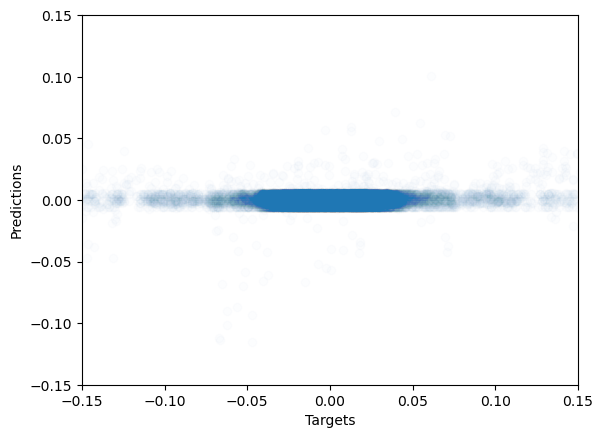

In [264]:
all_batches_fix3 = []
for i in all_batches3:
    for j in i:
        all_batches_fix3.append(j)

all_targets_x3 = [yuh[0] for yuh in all_batches_fix3]
#print(all_batches)
print(len(all_targets_x3))
all_predictions_x3 = [yuh[0] for yuh in all_predictions3]
print(np.array(all_predictions3).shape)
print(len(all_predictions_x3))
plt.scatter(all_targets_x3, all_predictions_x3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

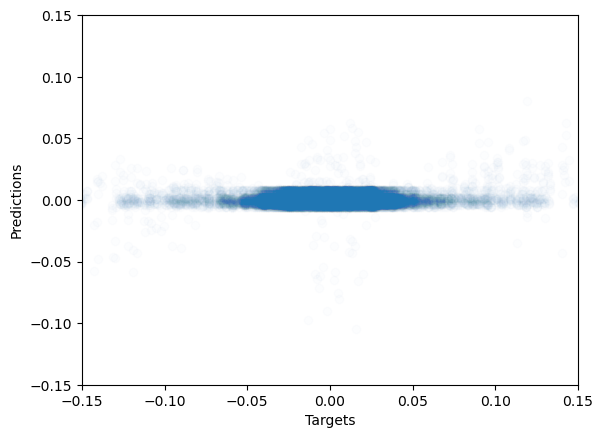

In [265]:
all_targets_y3 = [yuh[1] for yuh in all_batches_fix3]
print(len(all_targets_y3))
all_predictions_y3 = [yuh[1] for yuh in all_predictions3]
print(len(all_predictions_y3))
plt.scatter(all_targets_y3, all_predictions_y3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [286]:
norms = []
cur_targets_y = []
for target in all_targets_y3:
    norms.append(np.linalg.norm(target))

eps = 0.05

points_to_plot = np.array(all_targets_y3)[np.where(np.array(norms) > eps)]
preds = np.array(all_predictions_y3)[np.where(np.array(norms) > eps)]

points_to_plot

array([-0.05101025, -0.05588376, -0.05376405, ...,  0.06335173,
       -0.05252869,  0.05972029], dtype=float32)

Text(0, 0.5, 'Predictions')

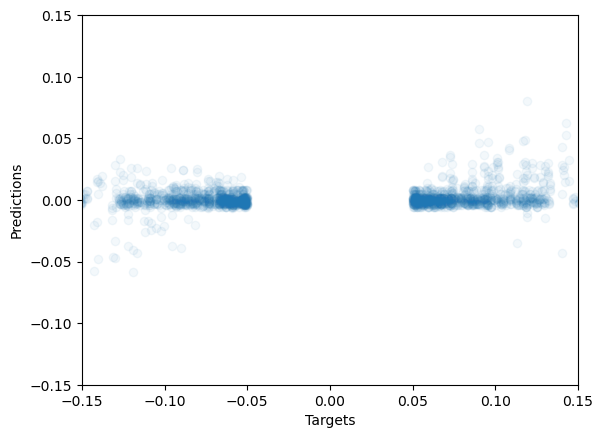

In [287]:
plt.scatter(points_to_plot, preds, alpha = 0.05)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

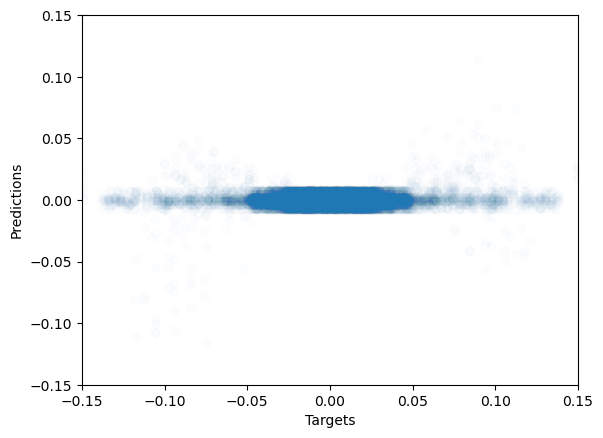

In [266]:
all_targets_z3 = [yuh[2] for yuh in all_batches_fix3]
print(len(all_targets_z3))
all_predictions_z3 = [yuh[2] for yuh in all_predictions3]
print(len(all_predictions_z3))
plt.scatter(all_targets_z3, all_predictions_z3, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

In [267]:
model4 = MLP(
    input_dim = traindatax.shape[1],
    output_dim = traindatay.shape[1],
    hidden_dim = 512,
    n_layers = 6,
    geometric_init = True,
    beta = True,
    sine=False,
    all_sine=False,
    skip=True,
    bn=True,
    dropout=0.0

)

In [268]:
trainingLoad2 = torch.utils.data.DataLoader(trainingDataset2, batch_size = 1000, shuffle = True)

lossfunc2 = torch.nn.MSELoss()
optimizer2 = torch.optim.Adam(model4.parameters(), .0001)

In [269]:
all_predictions4 = []
all_batches4 = []

In [270]:
for i in range(10):
    for batch in trainingLoad2:
        
        optimizer2.zero_grad()
        
        Xbatch = batch[0]
        Ybatch = batch[1]
        
        #print(Ybatch)
        
        predicts = model4(Xbatch)
        #print(predicts)
        
        if i == 9:
            for a in predicts:
                print(a)
                all_predictions4.append(a.detach().numpy())
                
            all_batches4.append(Ybatch.detach().numpy())
        
        error = lossfunc2(predicts, Ybatch)
        #print(predicts, Ybatch)
        print(error.detach().numpy())
        error.backward()
        
        optimizer2.step()

1.0012181
0.9146239
0.8161842
0.7212186
0.6294422
0.5509872
0.46989617
0.40222123
0.33245885
0.27467078
0.22353704
0.17695028
0.132818
0.101991296
0.07381206
0.058678705
0.04645272
0.026990732
0.019282773
0.011174511
0.009749697
0.008546101
0.022311285
0.008372006
0.019806964
0.02662945
0.024903605
0.032242306
0.027425969
0.02487967
0.023022093
0.015293895
0.015575859
0.0067396965
0.008721401
0.010078649
0.01588768
0.009077528
0.012761458
0.005955223
0.007374092
0.00817265
0.010218733
0.008442214
0.009324982
0.0076646716
0.0074742
0.003057847
0.0060072993
0.0067187073
0.0068961116
0.0069773146
0.0043152114
0.0075835497
0.005142521
0.005038034
0.006416827
0.005557765
0.0053802095
0.0032983525
0.004950338
0.0052359235
0.0028236446
0.0039752307
0.003981997
0.0038046734
0.0038569677
0.0038908757
0.0033118413
0.0043304744
0.0036248544
0.0026498658
0.0030908897
0.0021187526
0.003979161
0.0034280322
0.003673281
0.0046472107
0.004229391
0.0023146113
0.0032984714
0.004337716
0.004258964
0.00216

23042
(23042, 3)
23042


Text(0, 0.5, 'Predictions')

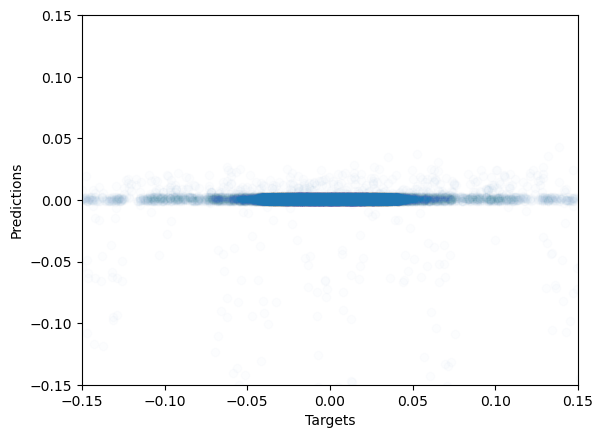

In [271]:
all_batches_fix4 = []
for i in all_batches4:
    for j in i:
        all_batches_fix4.append(j)

all_targets_x4 = [yuh[0] for yuh in all_batches_fix4]
#print(all_batches)
print(len(all_targets_x4))
all_predictions_x4 = [yuh[0] for yuh in all_predictions4]
print(np.array(all_predictions4).shape)
print(len(all_predictions_x4))
plt.scatter(all_targets_x4, all_predictions_x4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

23042
23042


Text(0, 0.5, 'Predictions')

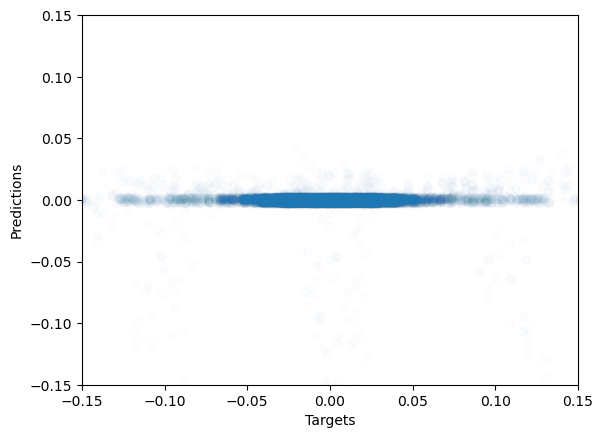

In [272]:
all_targets_y4 = [yuh[1] for yuh in all_batches_fix4]
print(len(all_targets_y4))
all_predictions_y4 = [yuh[1] for yuh in all_predictions4]
print(len(all_predictions_y4))
plt.scatter(all_targets_y4, all_predictions_y4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

Text(0, 0.5, 'Predictions')

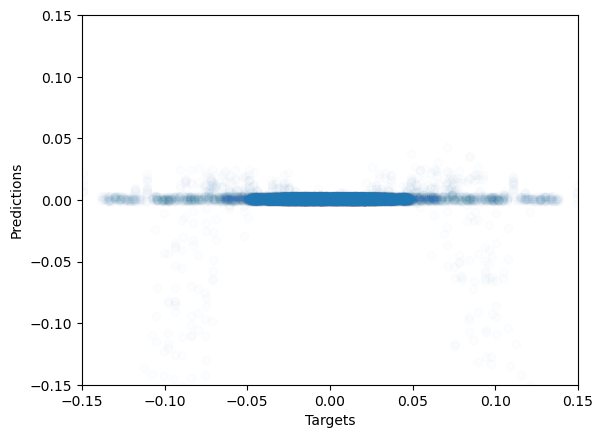

In [290]:
all_targets_z4 = [yuh[2] for yuh in all_batches_fix4]
#print(len(all_targets_z4))
all_predictions_z4 = [yuh[2] for yuh in all_predictions4]
#print(len(all_predictions_z4))
plt.scatter(all_targets_z4, all_predictions_z4, alpha = 0.01)
plt.xlim(-.15, .15)
plt.ylim(-.15, .15)
plt.xlabel("Targets")
plt.ylabel("Predictions")

- X predictions and y predictions function
- Figuring out output prediction graphs that are wrong